# Master file Potato

In this jupyter notebook, Team 2 in ENEL 645 presents classification of 3 potato plant diseases. We used the PlantVillage Dataset available on Kaggle to create our potato dataset. 

# 1. Configure Paths and Load Data



In [1]:
# download the Kaggle dataset instructions here:
# https://medium.com/analytics-vidhya/how-to-fetch-kaggle-datasets-into-google-colab-ea682569851a
# mount google drive
from google.colab import drive
drive.mount('/content/gdrive')

# configure path to Kaggle json file 
import os
os.environ['KAGGLE_CONFIG_DIR'] = "/content/gdrive/My Drive/Kaggle"
# /content/gdrive/My Drive/Kaggle is the path where kaggle.json is present in the Google Drive

#changing the working directory
%cd /content/gdrive/My Drive/Kaggle
#Check the present working directory using pwd command

#download kaggle dataset
# comment out so i dont re-download everytime
# !kaggle datasets download -d emmarex/plantdisease

#unzip the Plan Village Dataset
#unzipping the zip files and deleting the zip files
# !unzip \*.zip  && rm *.zip

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).
/content/gdrive/.shortcut-targets-by-id/1AE_ah6OZ6tuGxdM5Y8ousz-lKzgRa6TZ/Kaggle


#2.  Importing Libraries

In [2]:
import random as random
import pandas as pd
import numpy as np
import os
import tensorflow as tf
from sklearn import preprocessing
import cv2
from PIL import Image
from tensorflow import keras
from tensorflow.keras import layers, Input
from tensorflow.keras.models import Sequential, Model
from  matplotlib import pyplot as plt
import matplotlib.image as mpimg
from keras.regularizers import l2
%matplotlib inline

# 3. Data Preprocessing
To access our data, we used ImageDataGenerator. This allows image resizing and data augmentation to be easily completed. The result is a train, test and validation generator. We also have a generalized dataset to test our models generalizability. A general test generator was created for this dataset as well. 

In [3]:
print(os.getcwd())
data_dir=r'/content/gdrive/My Drive/Kaggle/PlantVillage_Sorted/'

general_data_dir=r'/content/gdrive/My Drive/General_Validation_Datasets/'

/content/gdrive/.shortcut-targets-by-id/1AE_ah6OZ6tuGxdM5Y8ousz-lKzgRa6TZ/Kaggle


### Potato Image Data Generator Classes

* Potato___Early_blight 
* Potato___Late_blight 
* Potato___healthy 


In [4]:
seed = 909 # (IMPORTANT) to input image and corresponding target with same augmentation parameter.
image_size = (250,250)
batch = 32
# the image hierarchy is important
# see: https://stackoverflow.com/questions/49535561/imagedatagenerator-on-a-folder

# kaggle --->PlantVillage folder
#               |
#               Development folder
#                   split the total amount of images into 80% development, 
#                   and this will be further split by dev_params into tran and val generators (in code)
#                         |___> all 9 classes exist in this folder with 80% of the total photos
#               |
#               |
#               Test folder
#                   split the total amount of images into 20% test
#                         |___> all 9 classes exist in this folder with 20% of the total photos

# General_Validation_Datasets
#               | Contains all classes with data found from general sources


# CREATE THE TRAIN/VAL GENERATORS HERE
# notice that i split the gen_params into 10% val 90% train 
dev_params = { "validation_split":0.1, "rescale":1.0/255,"featurewise_center":False,"samplewise_center":False,"featurewise_std_normalization":False,\
              "samplewise_std_normalization":False,"zca_whitening":False,"rotation_range":20,"width_shift_range":0.1,"height_shift_range":0.1,\
              "shear_range":0.2, "zoom_range":0.1,"horizontal_flip":True,"fill_mode":'nearest',\
               "cval": 0}

train_image_datagen = tf.keras.preprocessing.image.ImageDataGenerator(**dev_params) 
val_image_datagen = tf.keras.preprocessing.image.ImageDataGenerator(**dev_params) 

# use classes tag to only specify a certain class 
train_generator = train_image_datagen.flow_from_directory(data_dir+'development', subset = 'training', classes = ['Potato___Early_blight', 'Potato___Late_blight', 'Potato___healthy' ],
                                                     batch_size = batch,seed=seed, target_size=image_size,color_mode='rgb',shuffle = True)
val_generator = val_image_datagen.flow_from_directory(data_dir+'development', subset = 'validation', classes = ['Potato___Early_blight', 'Potato___Late_blight', 'Potato___healthy'],
                                                     batch_size = batch,seed=seed, target_size=image_size,color_mode='rgb',shuffle = True)

# CREATE THE TEST GENERATOR HERE
test_dir = data_dir+'test' # This is the test folder!!
test_params = {"rescale":1.0/255,"featurewise_center":False,"samplewise_center":False,"featurewise_std_normalization":False,\
              "samplewise_std_normalization":False,"zca_whitening":False,"rotation_range":20,"width_shift_range":0.1,"height_shift_range":0.1,\
              "shear_range":0.2, "zoom_range":0.1,"horizontal_flip":True,"fill_mode":'nearest',\
               "cval": 0}
test_image_datagen = tf.keras.preprocessing.image.ImageDataGenerator(**test_params) 
# use classes tag to only specify a certain class 
test_generator = train_image_datagen.flow_from_directory(test_dir, classes = ['Potato___Early_blight', 'Potato___Late_blight', 'Potato___healthy'],
                                                         batch_size = batch,seed=seed, target_size=image_size,color_mode='rgb',shuffle = True)

Found 1549 images belonging to 3 classes.
Found 172 images belonging to 3 classes.
Found 431 images belonging to 3 classes.


In [5]:
# CREATE THE GENERAL TEST GENERATOR HERE (testing dataset outside of PlantVillage)
test = 'ON' # turning this test case on/off
if test is 'ON':
  general_test_params = {"rescale":1.0/255,"featurewise_center":False,"samplewise_center":False,"featurewise_std_normalization":False,\
                "samplewise_std_normalization":False,"zca_whitening":False,"rotation_range":20,"width_shift_range":0.1,"height_shift_range":0.1,\
                "shear_range":0.2, "zoom_range":0.1,"horizontal_flip":True,"fill_mode":'nearest',\
                "cval": 0}

  general_test_image_datagen = tf.keras.preprocessing.image.ImageDataGenerator(**test_params) 

  # use classes tag to only specify a certain class
  general_test_generator = train_image_datagen.flow_from_directory(general_data_dir, classes = ['Potato___Early_blight', 'Potato___Late_blight', 'Potato___healthy'],
                                                          batch_size = batch,seed=seed, target_size=image_size,color_mode='rgb',shuffle = True)
else:
  pass

Found 31 images belonging to 3 classes.


### Exploring the Data

In [6]:
# I want to see the labels, lets access the keys in the dictionary
# https://stackoverflow.com/questions/48373685/keras-imagedatagenerator-how-to-get-all-labels-from-data
# train_generator.class_indices.keys()
# train_generator.class_indices.values()

for key, val in train_generator.class_indices.items(): # see the classes
  print(key, val)

# heres the labels, are they one hot encoded? No, and they dont have to be see Q's above
x= train_generator.next()
train_generator.labels

Potato___Early_blight 0
Potato___Late_blight 1
Potato___healthy 2


array([0, 0, 0, ..., 2, 2, 2], dtype=int32)

(32, 250, 250, 3)


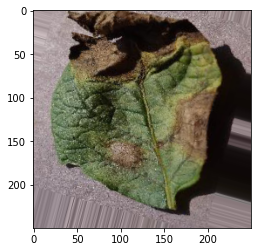

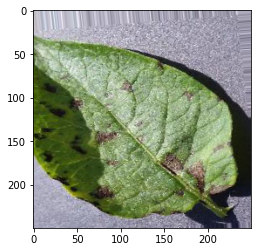

(31, 250, 250, 3)


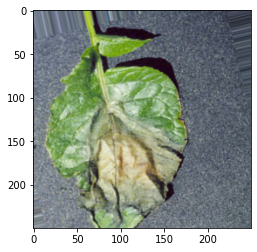

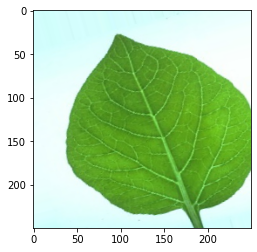

In [7]:
# from https://stackoverflow.com/questions/59217031/plot-images-from-image-generator
x= train_generator.next()
for i in range(0,1):
    image = x[i]
    print(image.shape) # (32, 250, 250, 3) this means theres 32 images per batch (batch, img_width, img_length, RGB)
    # since theres 32 images per batch lets use a for loop to display just the first 2 images
    for img in range(0,2):
      plt.imshow(image[img])
      plt.show()

if test is 'ON': 
  x= general_test_generator.next()
  for i in range(0,1):
      image = x[i]
      print(image.shape) # (32, image_size, 3) this means theres 32 images per batch (batch, img_width, img_length, RGB)
      # since theres 32 images per batch lets use a for loop to display just the first 2 images
      for img in range(0,2):
        plt.imshow(image[img])
        plt.show()
else:
  pass

# 4. Defining and Training a Model



In [8]:
def my_model_cnn(ishape = (250,250,3), k = 3, lr = 1e-3): # k = number of classes

    # ishape is the size of the images we have, which is 250 by 250 by 3 channels
    # k = 3 is number of classes 
    # lr is the learning rate 
    # https://machinelearningmastery.com/how-to-reduce-overfitting-in-deep-learning-with-weight-regularization/
    # kernel_regularizer=tf.keras.regularizers.l2(0.01)

    model_input = tf.keras.layers.Input(shape = ishape) # Input layer, 0 parameters

    l1 = tf.keras.layers.Conv2D(32, (3,3),  padding='same', activation='relu')(model_input) 
    l1 = tf.keras.layers.Conv2D(32, (3,3), padding='same', activation='relu')(l1) 
    l1 = tf.keras.layers.BatchNormalization()(l1)
    l1 = tf.keras.layers.MaxPool2D((2,2))(l1) 
    l1 = tf.keras.layers.Dropout(0.3)(l1) 
  
    
    l2 = tf.keras.layers.Conv2D(64, (3,3), padding='same', activation='relu')(l1)
    l2 = tf.keras.layers.Conv2D(64, (3,3), padding='same', activation='relu')(l2)
    l2 = tf.keras.layers.BatchNormalization()(l2)
    l2 = tf.keras.layers.MaxPool2D((2,2))(l2) 
    l2 = tf.keras.layers.Dropout(0.4)(l2) 
    
    
    l3 = tf.keras.layers.Conv2D(128, (3,3), padding='same', activation='relu')(l2)
    l3 = tf.keras.layers.Conv2D(128, (3,3), padding='same', activation='relu')(l3)
    l3 = tf.keras.layers.BatchNormalization()(l3)
    l3 = tf.keras.layers.MaxPool2D((2,2))(l3) 
    l3 = tf.keras.layers.Dropout(0.45)(l3) 
   

    flat = tf.keras.layers.Flatten()(l3) 

    out = tf.keras.layers.Dropout(0.5)(flat) 
    out = tf.keras.layers.Dense(k,activation = 'softmax')(out)
    model = tf.keras.models.Model(inputs = model_input, outputs = out)

    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=lr), loss='categorical_crossentropy', metrics = ["accuracy"])
    return model

model = my_model_cnn()
print(model.summary())

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 250, 250, 3)]     0         
_________________________________________________________________
conv2d (Conv2D)              (None, 250, 250, 32)      896       
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 250, 250, 32)      9248      
_________________________________________________________________
batch_normalization (BatchNo (None, 250, 250, 32)      128       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 125, 125, 32)      0         
_________________________________________________________________
dropout (Dropout)            (None, 125, 125, 32)      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 125, 125, 64)      18496 

In [9]:
# define your callbacks
# remember that you need to save the weights of your best model!
model_name = "test_model"
model_name_cnn = "test_model.h5"

early_stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience = 20)

monitor = tf.keras.callbacks.ModelCheckpoint(model_name_cnn, monitor='val_loss',\
                                             verbose=0,save_best_only=True,\
                                             save_weights_only=True,\
                                             mode='min')
# Learning rate schedule
def scheduler(epoch, lr):
    if epoch%10 == 0:
        lr = lr/2
    return lr

lr_schedule = tf.keras.callbacks.LearningRateScheduler(scheduler,verbose = 0)

# define your callbacks
# remember that you need to save the weights of your best model!

In [10]:
# train your model - decide for how many epochs
%load_ext tensorboard
import datetime
# used to clear previous logs on tensor board. 
! rm -rf ./logs/

In [11]:
# train your model - decide for how many epochs
log_dir = "logs/fit_cnn/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

model.fit(train_generator,batch_size = batch, epochs = 100, \
          verbose = 1, callbacks= [early_stop, monitor, lr_schedule, tensorboard_callback],validation_data= val_generator)

Epoch 1/100
49/49 [==============================] - 545s 11s/step - loss: 2.6544 - accuracy: 0.7400 - val_loss: 8.2070 - val_accuracy: 0.4651
Epoch 2/100
49/49 [==============================] - 28s 566ms/step - loss: 1.2323 - accuracy: 0.8813 - val_loss: 11.5392 - val_accuracy: 0.4651
Epoch 3/100
49/49 [==============================] - 28s 568ms/step - loss: 0.6492 - accuracy: 0.9047 - val_loss: 15.0794 - val_accuracy: 0.4477
Epoch 4/100
49/49 [==============================] - 28s 570ms/step - loss: 1.0246 - accuracy: 0.8800 - val_loss: 26.8092 - val_accuracy: 0.4651
Epoch 5/100
49/49 [==============================] - 28s 573ms/step - loss: 0.5306 - accuracy: 0.9346 - val_loss: 33.5762 - val_accuracy: 0.4651
Epoch 6/100
49/49 [==============================] - 28s 570ms/step - loss: 0.6172 - accuracy: 0.9397 - val_loss: 18.1668 - val_accuracy: 0.4651
Epoch 7/100
49/49 [==============================] - 28s 570ms/step - loss: 0.3388 - accuracy: 0.9452 - val_loss: 18.1466 - val_accu

# 5. Testing the model with the test generator

In [12]:
model.load_weights(model_name_cnn)
metrics = model.evaluate(test_generator) # Get metrics from generators
print("Categorical cross-entropy:", metrics[0])
print("Accuracy:", metrics[1])

14/14 [==============================] - 140s 11s/step - loss: 0.2763 - accuracy: 0.9606
Categorical cross-entropy: 0.2763422727584839
Accuracy: 0.9605568647384644


# 6. Testing the model with general test generator (images not from Plant Village Dataset)

In [13]:
if test is 'ON':
  model.load_weights(model_name_cnn)
  metrics = model.evaluate(general_test_generator)
  print("Categorical cross-entropy:", metrics[0])
  print("Accuracy:", metrics[1])
else:
  pass

1/1 [==============================] - 2s 2s/step - loss: 12.5274 - accuracy: 0.6129
Categorical cross-entropy: 12.527448654174805
Accuracy: 0.6129032373428345


### Displaying wrongly classified images

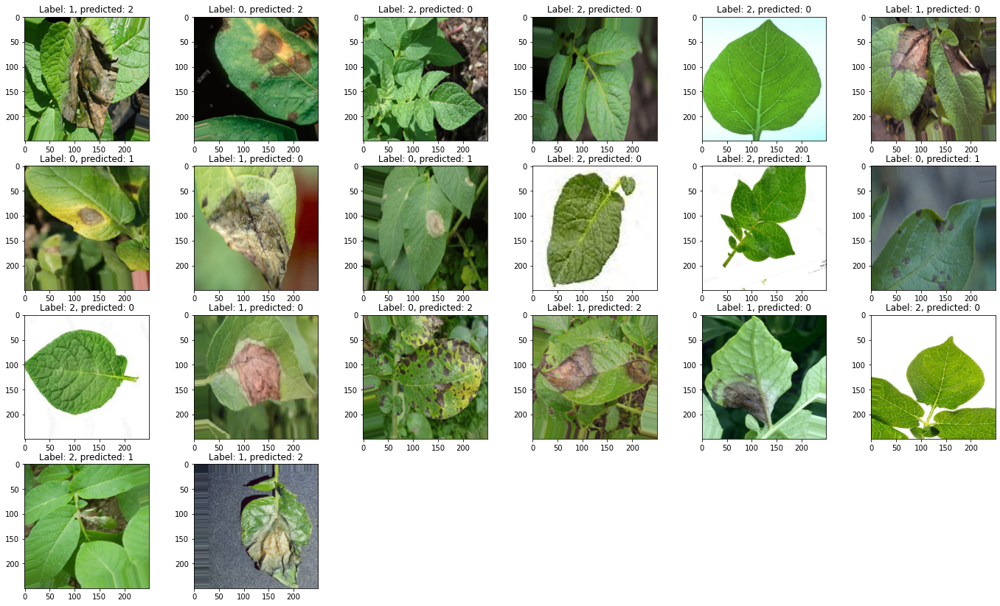

In [14]:
Ypred = model.predict(general_test_generator).argmax(axis = 1)
x,y = general_test_generator.next()

y = np.argmax(y, axis = 1)
wrong_indexes = np.where(Ypred != y)[0]

# Displaying images that were wrongly classified from the generalized dataset
sample_indexes = np.random.choice(np.arange(wrong_indexes.shape[0], dtype = int),size = wrong_indexes.size, replace = False)
plt.figure(figsize = (24,18))
for (ii,jj) in enumerate(sample_indexes):
    plt.subplot(5,6,ii+1)
    plt.imshow(x[wrong_indexes[jj]], cmap = "gray")
    plt.title("Label: %s, predicted: %s" %(y[wrong_indexes[jj]],Ypred[wrong_indexes[jj]]))
plt.show()

# 7. Display Loss and Accuracy with TensorBoard

In [15]:
%tensorboard --logdir logs/fit_cnn

<IPython.core.display.Javascript object>

# Save Model

In [16]:
# Save your model
%cd /content/gdrive/My Drive/
model.save("Potato_Colab.h5")


/content/gdrive/My Drive


In [ ]:
!ls